In [169]:
import os, sys, glob
import math
import numpy as np
import pandas as pd
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_context("notebook", font_scale=1.2)

In [170]:
def parseB(filename):
    df = pd.read_csv(filename, sep="\t")
    return df.values[:,10:].astype(float)

In [171]:
def parseU(filename):
    df = pd.read_csv(filename, sep="\t", index_col=0)
    return df.values.astype(float)

In [172]:
def parseF(filename):
    df = pd.read_csv(filename, sep="\t")
    return df.values[:,10:].astype(float)

In [173]:
def extractMask(F):
    return np.ma.masked_invalid(F).mask.astype(float)

In [492]:
F = parseF("new_real_data_reduced_sweep/k25_S0_filtered.tsv")

In [493]:
M = extractMask(F_k25)

# Frobenius norm

In [494]:
u, s, vh = np.linalg.svd(np.nan_to_num(F, nan=0.), full_matrices=False)

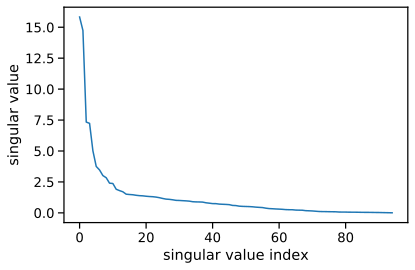

In [495]:
plt.plot(s)
# plt.gca().set_xlim((1,None))
plt.gca().set_ylabel("singular value")
plt.gca().set_xlabel("singular value index")
plt.tight_layout()
plt.savefig("singular_values_mask0.pdf")

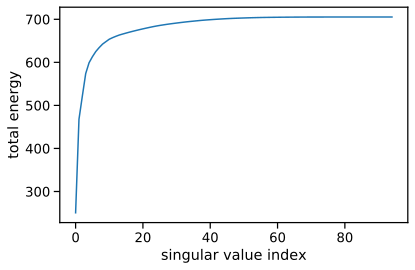

In [496]:
ss = np.cumsum(np.square(s))
plt.plot(ss)
# plt.axhline(y=0.90 * (np.max(ss) - np.min(ss)) + np.min(ss), color='r', linestyle='--')
plt.gca().set_ylabel("total energy")
plt.gca().set_xlabel("singular value index")
plt.tight_layout()
plt.savefig('cumsum_svd_sqr_real.pdf')

# BoxPlots and Jitter Plots

In [192]:
pwd

'/home/sashitt2/SARS-CoV-check/results'

In [210]:
np.sqrt(np.count_nonzero(~np.isnan(F)))

164.36240446038747

In [212]:
np.linalg.norm(np.nan_to_num(F), 'fro')

29.878487825542887

In [208]:
F.size

27248

In [497]:
dirname = 'new_real_data_reduced_sweep'

errorValues = []
nnzF = np.count_nonzero(~np.isnan(F))
normF = np.linalg.norm(np.nan_to_num(F), 'fro')

for k in range(5,51,5):
    for filename in os.listdir(dirname):
        if filename.startswith('k'+str(k)+'_') and filename.endswith('.error'):
            with open(os.path.join(dirname,filename),'r') as input:
                lines = input.readlines()
                #print(lines[-1])
                normError = float(lines[-1])/np.sqrt(nnzF)*normF
                errorValues.append([k, normError])
                
df_error = pd.DataFrame(errorValues, columns = ['k', 'error']) 

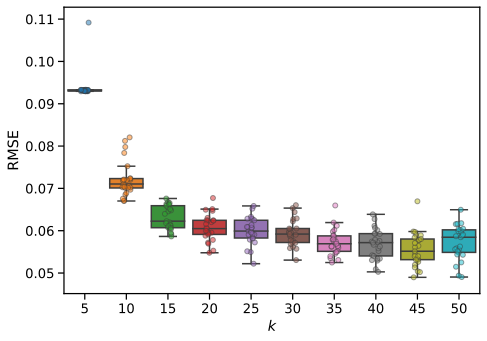

In [498]:
sns.boxplot(data=df_error,x="k", y="error", showfliers=False)
ax = sns.stripplot(data=df_error,x="k",y="error",
              alpha=.5, dodge=True, linewidth=1, jitter=.1)
plt.gca().set_xlabel("$k$")
plt.gca().set_ylabel("RMSE")
plt.gcf().set_size_inches(7, 5)
plt.tight_layout()

In [533]:
dirname = 'new_real_data_reduced_sweep'

missedMutations = []

for k in range(5,51,5):
    for filename in os.listdir(dirname):
        if filename.startswith('k'+str(k)+'_') and filename.endswith('_B.txt'):
            B = parseB(os.path.join(dirname,filename))
            assert(B.shape[0] == 95)
            num = B.shape[0] - np.count_nonzero(np.sum(B,axis=1))
            missedMutations.append([k, num, 95 - num])

df_missed = pd.DataFrame(missedMutations, columns = ['k', 'nMissing', 'nMutations'])             

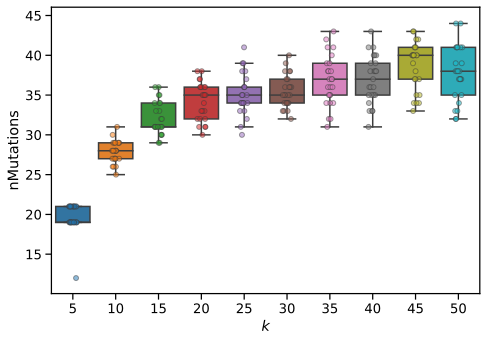

In [534]:
sns.boxplot(data=df_missed,x="k", y="nMutations", showfliers=False)
ax = sns.stripplot(data=df_missed,x="k",y="nMutations",
              alpha=.5, dodge=True, linewidth=1, jitter=.1)
plt.gca().set_xlabel("$k$")
plt.gca().set_ylabel("nMutations")
plt.gcf().set_size_inches(7, 5)
plt.tight_layout()

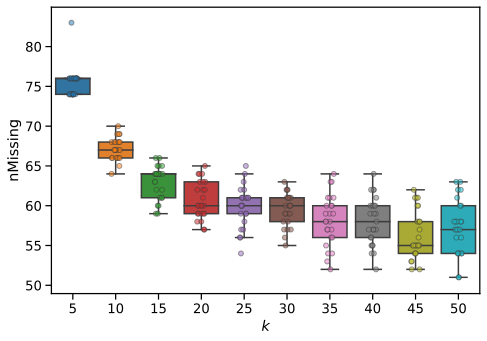

In [535]:
sns.boxplot(data=df_missed,x="k", y="nMissing", showfliers=False)
ax = sns.stripplot(data=df_missed,x="k",y="nMissing",
              alpha=.5, dodge=True, linewidth=1, jitter=.1)
plt.gca().set_xlabel("$k$")
plt.gca().set_ylabel("nMissing")
plt.gcf().set_size_inches(7, 5)
plt.tight_layout()

In [332]:
np.count_nonzero(np.sum(B,axis=1))

18

In [507]:
dirname = 'new_real_data_reduced_sweep'

nUniqueStrains = []

for k in range(5,51,5):
    for filename in os.listdir(dirname):
        if filename.startswith('k'+str(k)+'_') and filename.endswith('_B.txt'):
            B = parseB(os.path.join(dirname,filename))
            assert(B.shape[0] == 95)
            num = np.unique(B, axis=1).shape[1]
            nUniqueStrains.append([k, num])

df_unique = pd.DataFrame(nUniqueStrains, columns = ['k', 'nUnique'])             

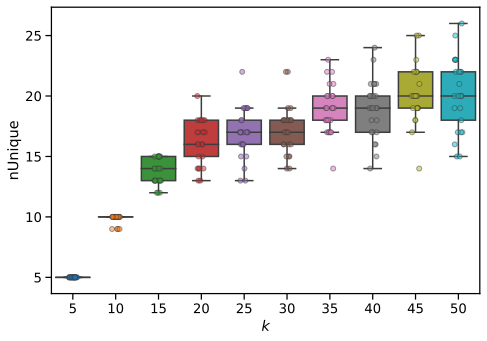

In [508]:
sns.boxplot(data=df_unique,x="k", y="nUnique", showfliers=False)
ax = sns.stripplot(data=df_unique,x="k",y="nUnique",
              alpha=.5, dodge=True, linewidth=1, jitter=.1)
plt.gca().set_xlabel("$k$")
plt.gca().set_ylabel("nUnique")
plt.gcf().set_size_inches(7, 5)
plt.tight_layout()

# Error scatter plot for k= 25

In [511]:
F = parseF("new_real_data_reduced_sweep/k25_S0_filtered.tsv")
B = parseB("new_real_data_reduced_sweep/k25_S0_B.txt")
U = parseU("new_real_data_reduced_sweep/k25_S0_U.txt")
E = F - np.dot(B, U)

In [512]:
df_input.head()

,,,gene,N/S,AA,nSRAsubclonal,nSRAclonal,nSRA,nConsensus,SRR10948474|China,SRR11059940|China:Wuhan,SRR11059942|China:Wuhan,...,SRR11494730|Australia: Victoria,SRR11494740|Australia: Victoria,SRR11494742|Australia: Victoria,SRR11494743|Australia: Victoria,SRR11494744|Australia: Victoria,SRR11494745|Australia: Victoria,SRR11494748|Australia: Victoria,SRR11494753|Australia: Victoria,SRR11494759|Australia: Victoria,SRR11494762|Australia: Northern Territory
pos,ref,alt,,,,,,,,,,,,,,,,,,,,,
241,C,T,noncoding,NaN,NaN,3,205,208,1246,0.0,0.0,NaN,...,0.000000,0.0,1.0,0.355932,1.000000,0.000000,0.000000,0.938650,0.0,0.00000
379,C,A,ORF1a,S,V38V,2,5,7,2,0.0,0.0,NaN,...,0.000000,0.0,0.0,0.000000,0.007143,0.000000,0.000000,0.000000,0.0,0.00000
404,A,T,ORF1a,N,K47*,4,1,5,0,0.0,0.0,NaN,...,0.009615,0.0,0.0,0.024390,0.000000,0.008772,0.008065,0.000000,0.0,0.00813
490,T,A,ORF1a,N,D75E,1,23,24,6,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.00000
527,C,T,ORF1a,S,L88L,0,1,1,0,0.0,0.0,0.0,...,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.052632,0.0,0.00000


In [513]:
errorList = []

for i in range(E.shape[0]):
    error = np.linalg.norm(np.nan_to_num(E[i][:]))
    #nHave = np.count_nonzero(np.nan_to_num(F[i][:]))
    nHave = (np.nan_to_num(F[i][:]) >= 0.05).sum()
    #nHave = np.linalg.norm(np.nan_to_num(F[i][:]))
    errorList.append([nHave, error/nHave])

df_errorList = pd.DataFrame(errorList, columns = ['nHave', 'error'])

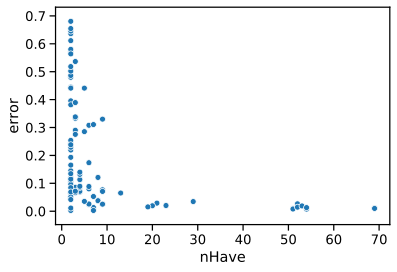

In [514]:
ax = sns.scatterplot(x="nHave", y="error", data=df_errorList)

# sample list and mutation list

In [515]:
df_input = pd.read_csv("new_real_data_reduced_sweep/k25_S0_filtered.tsv", sep='\t', index_col=[0,1,2])

In [516]:
df_input.columns

Index(['gene', 'N/S', 'AA', 'nSRAsubclonal', 'nSRAclonal', 'nSRA',
       'nConsensus', 'SRR11059940|China:Wuhan', 'SRR11059942|China:Wuhan',
       'SRR11059944|China:Wuhan',
       ...
       'SRR11494730|Australia: Victoria', 'SRR11494740|Australia: Victoria',
       'SRR11494742|Australia: Victoria', 'SRR11494743|Australia: Victoria',
       'SRR11494744|Australia: Victoria', 'SRR11494745|Australia: Victoria',
       'SRR11494748|Australia: Victoria', 'SRR11494753|Australia: Victoria',
       'SRR11494759|Australia: Victoria',
       'SRR11494762|Australia: Northern Territory'],
      dtype='object', length=168)

In [517]:
sampleList = open('/scratch/data/covid19/scripts/sampleList.txt', 'w')
for col in df_input.columns[7:]:
    #print(col.split('|')[0])
    sampleList.write(col.split('|')[0]+'\n')
sampleList.close()

In [518]:
for col in df_input.columns:
    print(col)

gene
N/S
AA
nSRAsubclonal
nSRAclonal
nSRA
nConsensus
SRR11059940|China:Wuhan
SRR11059942|China:Wuhan
SRR11059944|China:Wuhan
SRR11059945|China:Wuhan
SRR11059946|China:Wuhan
SRR11059947|China:Wuhan
SRR11092062|China: Wuhan
SRR11177792|Nepal: Kathmandu
SRR11241254|USA: Seattle\, WA
SRR11241255|USA: Seattle\, WA
SRR11247076|USA: WA
SRR11247077|USA: WA
SRR11247078|USA: WA
SRR11278091|USA:WA
SRR11278164|USA:WA
SRR11278166|USA:WA
SRR11278167|USA:WA
SRR11397717|Australia: Melbourne\, Victoria
SRR11397719|Australia: Melbourne\, Victoria
SRR11397720|Australia: Melbourne\, Victoria
SRR11397728|Australia: Melbourne\, Victoria
SRR11410528|USA
SRR11410536|USA
SRR11426414|Germany: Starnberg
SRR11426415|Germany: Starnberg
SRR11426417|Germany: Starnberg
SRR11426418|Germany: Starnberg
SRR11454607|China: Hubei
SRR11454608|China: Hubei
SRR11454609|China: Hubei
SRR11454613|China: Hubei
SRR11454614|China: Hubei
SRR11454615|China: Hubei
SRR11476445|USA: Washington
SRR11479027|USA
SRR11479029|USA
SRR11479031

In [433]:
for ind in df_input.index:
    if df_input.nSRAsubclonal[ind] > 0:
        print(ind, df_input.nSRAsubclonal[ind], df_input.nSRAclonal[ind])

(241, 'C', 'T') 3 205
(379, 'C', 'A') 2 5
(404, 'A', 'T') 4 1
(490, 'T', 'A') 1 23
(565, 'T', 'C') 1 0
(683, 'C', 'T') 1 0
(957, 'G', 'A') 2 0
(1015, 'A', 'G') 2 0
(1059, 'C', 'T') 3 83
(1515, 'A', 'G') 1 5
(1589, 'G', 'T') 2 0
(1887, 'C', 'T') 3 0
(2198, 'G', 'A') 20 0
(2891, 'G', 'A') 3 3
(3037, 'C', 'T') 2 205
(3096, 'C', 'T') 2 4
(3564, 'G', 'T') 2 0
(3784, 'C', 'T') 1 1
(3839, 'G', 'A') 2 1
(5617, 'G', 'T') 2 0
(6814, 'T', 'C') 1 1
(7011, 'C', 'T') 1 5
(7042, 'G', 'T') 1 1
(7355, 'C', 'T') 1 0
(7382, 'C', 'A') 2 0
(7507, 'A', 'C') 3 0
(8628, 'A', 'T') 2 0
(8782, 'C', 'T') 6 107
(9223, 'C', 'T') 5 2
(9803, 'C', 'T') 1 1
(10771, 'T', 'C') 1 4
(10779, 'T', 'A') 7 1
(11083, 'G', 'T') 8 78
(11335, 'G', 'T') 5 0
(11376, 'G', 'T') 1 1
(11454, 'C', 'A') 2 0
(11471, 'C', 'T') 1 0
(11671, 'C', 'T') 2 0
(12164, 'G', 'T') 1 0
(13112, 'T', 'A') 2 0
(14408, 'C', 'T') 1 209
(14805, 'C', 'T') 3 56
(15760, 'G', 'A') 1 2
(15898, 'G', 'T') 1 0
(15900, 'T', 'C') 2 1
(16508, 'G', 'T') 1 0
(16733, 'C',

In [396]:
# posList = open('posList.txt','w')
# for i in df_input.index:
#     #print(df_input.pos[i], df_input.ref[i], df_input.alt[i])
#     posList.write(str(df_input.pos[i])+"\t"+str(df_input.ref[i])+"\t"+str(df_input.alt[i]) + "\n")
# posList.close()

In [419]:
df_input = pd.read_csv("real_data_reduced/k25_S0_filtered.tsv", sep='\t', index_col=[0,1,2])

for col in df_input.columns[7:]:
    sampleName = col.split('|')[0]
    indexList = open('/scratch/data/covid19/scripts/indexFiles/'+sampleName+'_indexList.txt','w')
    for ind in df_input.index:
        if df_input[col][ind] > 0.05:
            indexList.write("\t".join(map(str, ind)) + "\n")
    indexList.close()

In [411]:
len(df_input.columns[10:])

205

# cluster map

In [536]:
B = parseB("new_real_data_reduced_sweep/k25_S11_B.txt")

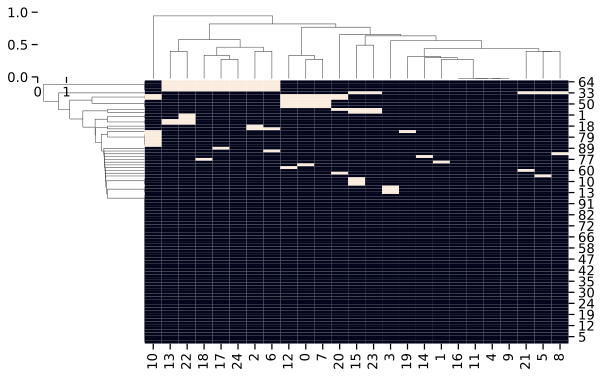

In [537]:
sns.clustermap(B, cbar=False)
cm.cax.set_visible(False)
plt.gcf().set_size_inches(8,5)

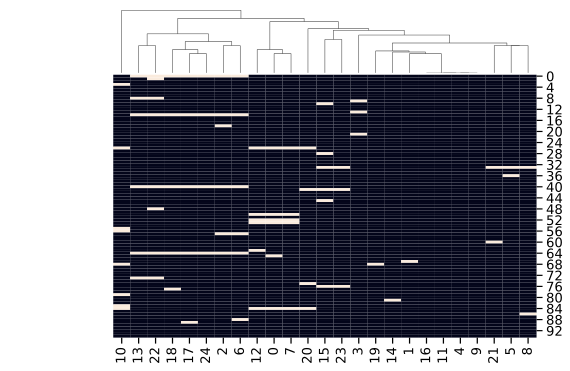

In [538]:
cm = sns.clustermap(B, cbar=False, row_cluster=False, cbar_kws = None)
#plt.gca().set_xticks([])
#plt.gca().set_yticks([])
cm.cax.set_visible(False)
plt.gcf().set_size_inches(8,5)

In [230]:
iris = sns.load_dataset("iris")

In [231]:
iris.head()

,sepal_length,sepal_width,petal_length,petal_width,species
0,5.1,3.5,1.4,0.2,setosa
1,4.9,3.0,1.4,0.2,setosa
2,4.7,3.2,1.3,0.2,setosa
3,4.6,3.1,1.5,0.2,setosa
4,5.0,3.6,1.4,0.2,setosa


# categorical row heatmap

In [522]:
def getLocations(filename_U):
    df_U = pd.read_csv(filename_U, sep='\t', index_col = [0])
    locations = []
    loc2idx = {}
    count = 0
    for col in df_U.columns:
        loc = col.split('|')[-1].replace('\\','').replace(' ','').split(':')[0]
        if loc not in loc2idx:
            loc2idx[loc] = count
            count += 1
        locations.append(loc)
    return locations, loc2idx

In [539]:
U = parseU("new_real_data_reduced_sweep/k25_S11_U.txt")
locations, loc2idx = getLocations("new_real_data_reduced_sweep/k25_S11_U.txt")

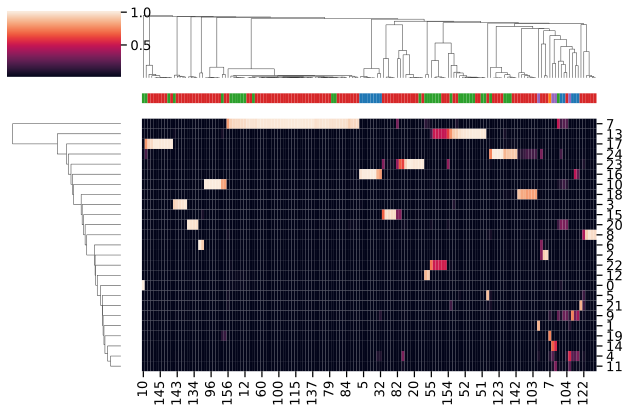

In [544]:
row_colors = list(map(lambda x : sns.color_palette()[loc2idx[x]], locations))
cm = sns.clustermap(U, col_colors=row_colors)
#plt.gca().set_xticks([])
#plt.gca().set_yticks([])
# cm.cax.set_visible(False)
plt.gcf().set_size_inches(9,6)
plt.tight_layout()

In [547]:
df_B = pd.read_csv('new_real_data_reduced_sweep/k25_S11_B.txt', sep='\t')

In [548]:
df_B.head()

,pos,ref,alt,gene,N/S,AA,nSRAsubclonal,nSRAclonal,nSRA,nConsensus,...,strain15,strain16,strain17,strain18,strain19,strain20,strain21,strain22,strain23,strain24
0,241,C,T,noncoding,NaN,NaN,3,184,187,1246,...,0,0,1,1,0,0,0,1,0,1
1,379,C,A,ORF1a,S,V38V,2,5,7,2,...,0,0,0,0,0,0,0,1,0,0
2,404,A,T,ORF1a,N,K47*,4,1,5,0,...,0,0,0,0,0,0,0,0,0,0
3,490,T,A,ORF1a,N,D75E,1,23,24,6,...,0,0,0,0,0,0,0,0,0,0
4,527,C,T,ORF1a,S,L88L,0,1,1,0,...,0,0,0,0,0,0,0,0,0,0


In [564]:
np.nonzero(np.asarray(list(df_B.strain7)))[0]

array([26, 50, 52, 53, 84])

# Looking at mutations in some of the strains

In [567]:
temp = list(np.nonzero(np.asarray(list(df_B.strain7))))[0]
for i in range(len(temp)):
    print(df_B.pos[temp[i]], df_B.ref[temp[i]], df_B.alt[temp[i]])

8782 C T
17747 C T
17858 A G
18060 C T
28144 T C


In [568]:
temp = list(np.nonzero(np.asarray(list(df_B.strain13))))[0]
for i in range(len(temp)):
    print(df_B.pos[temp[i]], df_B.ref[temp[i]], df_B.alt[temp[i]])

241 C T
1059 C T
3037 C T
14408 C T
23403 A G
25563 G T


In [569]:
temp = list(np.nonzero(np.asarray(list(df_B.strain17))))[0]
for i in range(len(temp)):
    print(df_B.pos[temp[i]], df_B.ref[temp[i]], df_B.alt[temp[i]])

241 C T
3037 C T
14408 C T
23403 A G
28882 G A


In [570]:
temp = list(np.nonzero(np.asarray(list(df_B.strain24))))[0]
for i in range(len(temp)):
    print(df_B.pos[temp[i]], df_B.ref[temp[i]], df_B.alt[temp[i]])

241 C T
3037 C T
14408 C T
23403 A G


In [578]:
temp = list(np.nonzero(np.asarray(list(df_B.strain11
                                      ))))[0]
for i in range(len(temp)):
    print(df_B.pos[temp[i]], df_B.ref[temp[i]], df_B.alt[temp[i]])

27676 G T


In [179]:
B = parseB("real_data_reduced/k25_S0_B.txt")

In [180]:
B[:,5].nonzero()

(array([ 34,  64,  66,  68, 115]),)

In [181]:
B[34,5]

1.0

In [525]:
df_B = pd.read_csv("new_real_data_reduced_sweep/k25_S0_B.txt",sep='\t', index_col=[0,1,2,3,5])

In [526]:
df_B.head()

,,,,,N/S,nSRAsubclonal,nSRAclonal,nSRA,nConsensus,strain0,strain1,strain2,strain3,strain4,...,strain15,strain16,strain17,strain18,strain19,strain20,strain21,strain22,strain23,strain24
pos,ref,alt,gene,AA,,,,,,,,,,,,,,,,,,,,,
241,C,T,noncoding,NaN,NaN,3,184,187,1246,0,0,0,0,0,...,0,1,0,0,0,0,1,0,0,0
379,C,A,ORF1a,V38V,S,2,5,7,2,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
404,A,T,ORF1a,K47*,N,4,1,5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
490,T,A,ORF1a,D75E,N,1,23,24,6,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
527,C,T,ORF1a,L88L,S,0,1,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [527]:
print(df_B.index[34])
print(df_B.index[64])
print(df_B.index[66])
print(df_B.index[68])
print(df_B.index[115])

(11376, 'G', 'T', 'ORF1a', 'G3704V')
(23403, 'A', 'G', 'S', 'D614G')
(23557, 'C', 'T', 'S', 'P665P')
(24034, 'C', 'T', 'S', 'N824N')


IndexError: index 115 is out of bounds for axis 0 with size 95

In [ ]:
sns.heatmap(B, cbar=False)
plt.gca().set_ylabel("mutations")
plt.gca().set_xlabel("strains")
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gcf().set_size_inches(8,5)

In [542]:
U = parseU("new_real_data_reduced_sweep/k25_S11_U.txt")

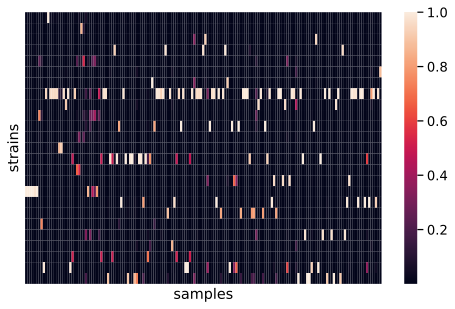

In [543]:
sns.heatmap(U)
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("strains")
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gcf().set_size_inches(8,5)

In [168]:
sns.heatmap(F, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("mutations")
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [68]:
sns.heatmap(F - np.dot(B, U), center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("mutations")
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [ ]:
with open("simulations.tsv", "w") as f:
    f.write("\t".join(["s", "M", "k", "S", "frob"]) + "\n")
    for filename in glob.glob("simulations/*_filtered.tsv"):
        dirname = os.path.dirname(filename)
        basename = os.path.basename(filename)
        l = basename.split('_')
        s = int(l[0][1:])
        missingStr = l[1][1:]
        missing = float(missingStr)
        k = int(l[2][1:])
        S = int(l[3][1:])

        F = parseF(filename)
        M = extractMask(F)

        filename_B = "%s/s%d_M%s_k%d_S%d_B.txt" % (dirname, s, missingStr, k, S)
        B = parseB(filename_B)

        filename_U = "%s/s%d_M%s_k%d_S%d_U.txt" % (dirname, s, missingStr, k, S)
        U = parseU(filename_U)

        frob = np.linalg.norm(np.nan_to_num(F - np.dot(B,U)))
        
        f.write("\t".join(map(str, [s, missingStr, k, S, frob])) + "\n")

In [ ]:
df = pd.read_csv("simulations.tsv", sep="\t")

In [ ]:
df['min_frob'] = df.groupby(["s", "M", "k"])["frob"].transform(min)
df["selected"] = df.apply(lambda x: x["min_frob"] == x["frob"], axis=1)

In [ ]:
sns.stripplot(data=df[df["selected"]], x="k", y="frob", hue="M", 
              alpha=.4, dodge=True, linewidth=1, jitter=.1,)
sns.boxplot(data=df[df["selected"]], x="k", y="frob", hue="M", 
            showfliers=False)
handles, labels = plt.gca().get_legend_handles_labels()
plt.gca().legend(handles[0:2], labels[0:2])
plt.gca().set_ylabel("$||M \circ(F - BU)||_\mathrm{F}$")
plt.tight_layout()
plt.savefig("frob.png")

In [442]:
removeList = ['SRR10948474',
'SRR11140745',
'SRR11140747',
'SRR11140749',
'SRR11140751',
'SRR11178051',
'SRR11178052',
'SRR11178053',
'SRR11178054',
'SRR11178055',
'SRR11178056',
'SRR11178057',
'SRR11267570',
'SRR11393273',
'SRR11393274',
'SRR11393275',
'SRR11393277',
'SRR11393278',
'SRR11397726',
'SRR11397727',
'SRR11410121',
'SRR11410122',
'SRR11410123',
'SRR11410124',
'SRR11410530',
'SRR11410534',
'SRR11410537',
'SRR11410539',
'SRR11433882',
'SRR11433885',
'SRR11433886',
'SRR11433890',
'SRR11445485',
'SRR11483104',
'SRR11483105',
'SRR11483106',
'SRR11483107',
'SRR11483109',
'SRR11483110',
'SRR11483111']

In [452]:
#df_input.head()
df_input2 = df_input.copy()

coldict = {}
for col in df_input.columns:
    newcol = col.split('|')[0]
    coldict[col] = newcol

In [456]:
df_input2 = df_input2.rename(columns=coldict)

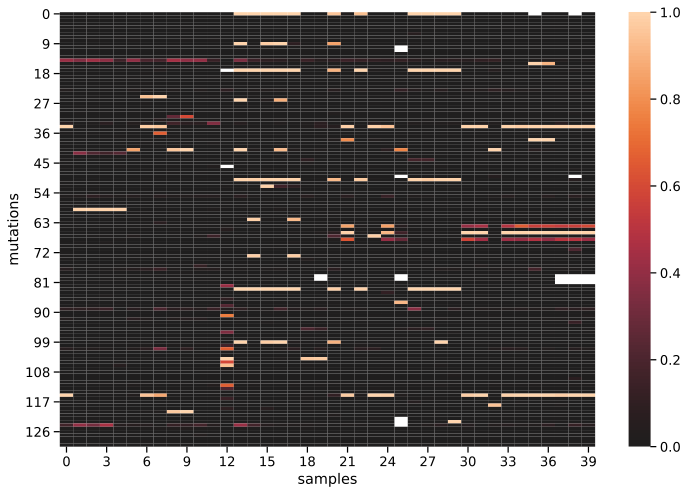

In [464]:
sns.heatmap(df_input2[removeList].values, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("mutations")
#plt.gca().set_xticks([])
#plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [465]:
sns.heatmap(df_input2[list(set(df_input2.columns[10:]).difference(removeList))].values, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("mutations")
#plt.gca().set_xticks([])
#plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [654]:
U = parseU("new_real_data_reduced_sweep/k25_S11_U.txt")

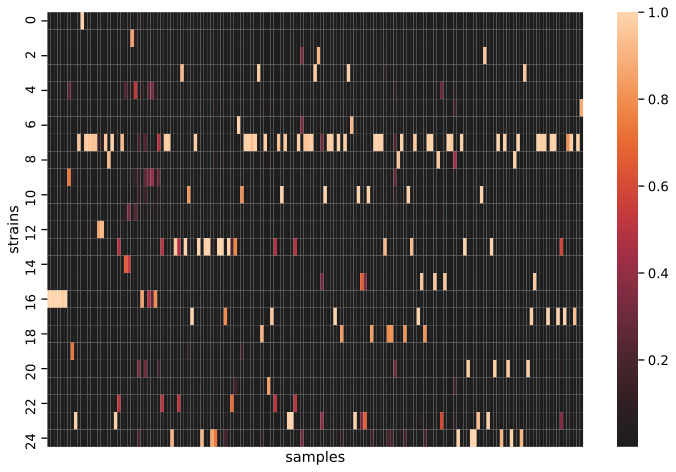

In [655]:
sns.heatmap(U, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("strains")
plt.gca().set_xticks([])
#plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [645]:
B = parseB("new_real_data_reduced_sweep/k25_S11_B.txt")
B_unique, indices = np.unique(B, axis=1, return_index=True)

In [646]:
B_unique.shape

(95, 22)

In [647]:
indices

array([ 4, 14, 19,  1,  8, 21, 23,  5,  7,  0, 12, 20, 15,  3, 10, 24, 17,
       18,  6,  2, 13, 22])

In [648]:
len(indices)

22

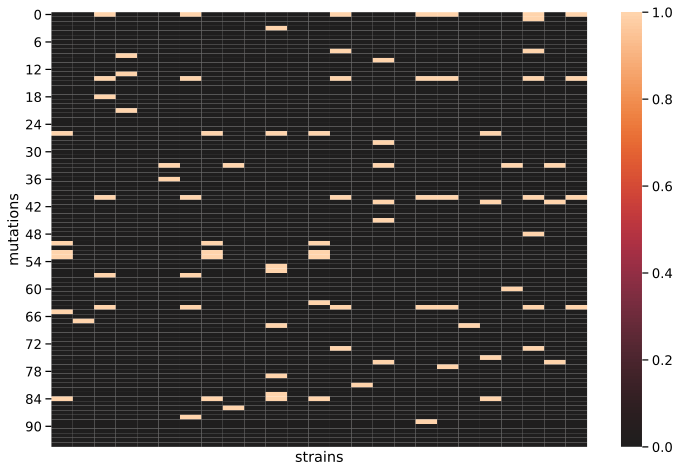

In [649]:
sns.heatmap(B, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("strains")
plt.gca().set_ylabel("mutations")
plt.gca().set_xticks([])
#plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [650]:
B_unique_list = []
collapseMatrix = []
for i in range(B.shape[1]):
    bvec = list(B[:,i])
    if bvec not in B_unique_list:
        B_unique_list.append(bvec)
        collapseVec = []
        nsame = 0
        for j in range(B.shape[1]):
            if bvec == list(B[:,j]):
                collapseVec.append(1)
                nsame += 1
            else:
                collapseVec.append(0)
        collapseMatrix.append(collapseVec)            
        print(nsame)

1
1
1
1
4
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


In [651]:
colMatrixnp = np.asarray(collapseMatrix)

In [652]:
colMatrixnp.shape

(22, 25)

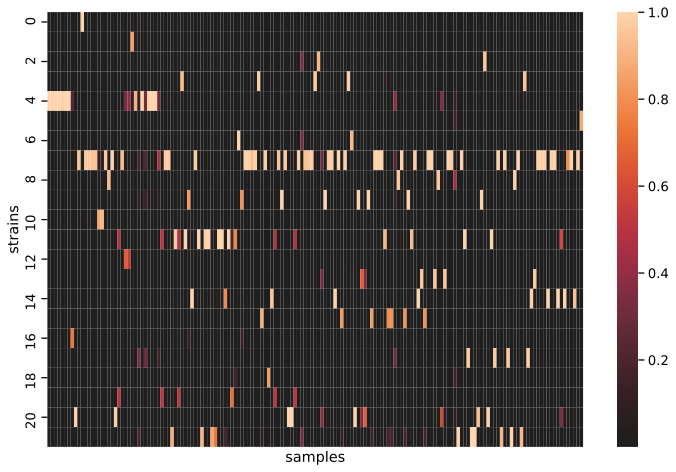

In [658]:
Ucollapse = np.dot(colMatrixnp,U)
sns.heatmap(Ucollapse, center=0)#palette=sns.diverging_palette(-1., 1., n=9))
plt.gca().set_xlabel("samples")
plt.gca().set_ylabel("strains")
plt.gca().set_xticks([])
#plt.gca().set_yticks([])
plt.gcf().set_size_inches(12,8)

In [666]:
df_U = pd.read_csv("new_real_data_reduced_sweep/k25_S11_U.txt")

for i in range(Ucollapse.shape[1]):
    if np.count_nonzero(Ucollapse[:,i] > 0.01) > 1:
        print(i)        

4
7
9
11
12
13
14
15
16
17
18
21
22
23
24
25
26
27
29
33
34
35
36
37
38
39
40
42
44
46
47
49
50
52
53
55
56
58
61
63
64
66
67
68
69
71
74
76
77
78
80
81
82
84
85
88
91
94
95
97
101
102
103
104
105
107
109
110
112
113
116
117
118
119
121
122
126
129
131
134
136
138
140
142
143
144
146
154
156
158
159
160


In [667]:
print(Ucollapse[:,-1])

[1.510280e-03 1.000000e-04 1.000000e-04 1.000000e-04 4.474326e-02
 8.818800e-01 1.000000e-04 1.000000e-04 2.890080e-02 1.000000e-04
 1.000000e-04 1.000000e-04 1.000000e-04 1.000000e-04 1.000000e-04
 1.000000e-04 1.000000e-04 1.000000e-04 2.890850e-02 1.000000e-04
 1.425870e-02 1.000000e-04]


(22, 25)

In [619]:
np.asarray(B_unique_list).shape

(22, 95)

In [607]:
for i in range(len(B_unique_list)):
    print(B_unique_list[i])

[0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 1.0, 1.0, 0.0, 0.0, 0.0, 1.0, 0.0, 1.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


In [608]:
len(B_unique_list[0])

25

In [610]:
B.shape

(95, 25)

In [613]:
len(B[:,1])

95